# ENPM673 Project 3

By: Sachin Jadhav (119484524)

In [1]:
# Connect to drive and change to required
# ENSURE YOU GIVE ALL THE PERMISSIONS WHILE CONNECTIONG
# YOUR GOOGLE DRIVE USING THS COMMAND
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [2]:
# Change the working directory
path_to_folder = "ENPM673/tutorials/assets"
%cd /content/drive/My\ Drive/{path_to_folder}

/content/drive/My Drive/ENPM673/tutorials/assets


In [3]:
import cv2
import numpy as np
import math
import glob
import pickle
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from IPython.display import clear_output

### FIND CHESSBOARD CORNERS - OBJECT POINTS AND IMAGE POINTS

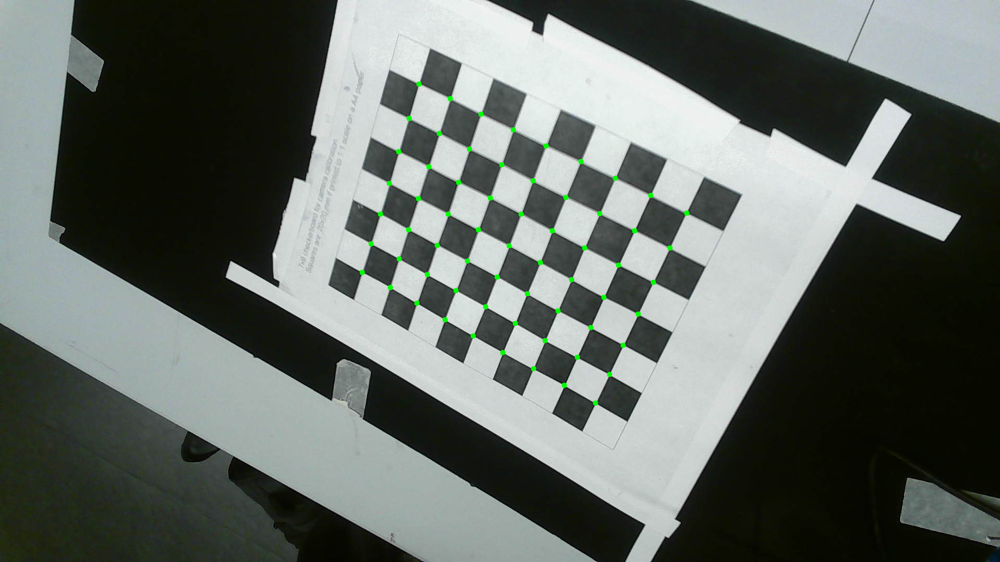

In [4]:
# here we specify the chessboard size chosen which will be used to trace the obj_points and store the img_points
chessboardSize = (9,7)
# Image Size
frameSize = (1920, 1080)

# Defining the Termination criteria to terminate the code if it suprpasses maximum allowed iterations or falls short of min required accuracy epsilon
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Prepare object points, in a numpy grid for the chessboarsize dimension
objp = np.zeros((chessboardSize[0] * chessboardSize[1], 3), np.float32)
objp[:,:2] = np.mgrid[0:chessboardSize[0],0:chessboardSize[1]].T.reshape(-1,2)

# This converts objp to store chessboard squares in terms of distance from each other
size_of_chessboard_squares_mm = 20
objp = objp * size_of_chessboard_squares_mm

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

# Load the images
index = 0
images = glob.glob('Project3/original/*.jpg')
# print(images)

for image_path in images:
    index += 1
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # This
    ret, corners = cv2.findChessboardCorners(gray, chessboardSize, None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        # This function detects corners with a subpixel accuracy
        corners2 = cv2.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)
        corners2 = corners2.flatten()
        # Plots the corners detected
        for i in range(0, len(corners2), 2):
            x, y = int(corners2[i]), int(corners2[i+1])
            cv2.circle(img, (x, y), 5, (0, 255, 0), -1)

        '''
        Request to create folder named detected_corners in the Project3 folder to collect the chess board corners
        '''
        cv2.imwrite('Project3/detected_corners/image' + str(index) + '.jpg', img)
        cv2_imshow(img)
        clear_output(True)

# CALIBRATION

In [5]:
ret, cameraMatrix, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, frameSize, None, None)

# Saves the camera calibration result for later use
pickle.dump((cameraMatrix, dist), open( "Project3/Calibration_data/calibration.pkl", "wb" ))
pickle.dump(cameraMatrix, open( "Project3/Calibration_data/cameraMatrix.pkl", "wb" ))
pickle.dump(dist, open( "Project3/Calibration_data/dist.pkl", "wb" ))

# UNDISTORTION

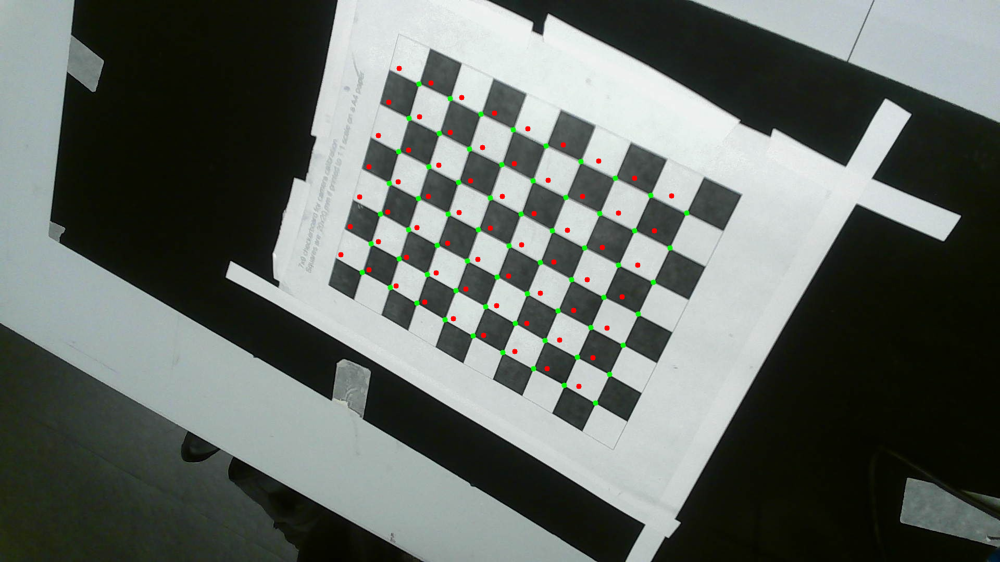

In [6]:
index = 0
images = glob.glob('Project3/original/*.jpg')
for img in images:
    index += 1
    img = cv2.imread(img)
    h, w = img.shape[:2]
    newCameraMatrix, roi = cv2.getOptimalNewCameraMatrix(cameraMatrix, dist, (w,h), 1, (w,h))


    # Undistort
    dst = cv2.undistort(img, cameraMatrix, dist, None, newCameraMatrix)

    # crop the image
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]
    # cv2.imwrite('caliResult1.jpg', dst)


    # Undistort with Remapping
    mapx, mapy = cv2.initUndistortRectifyMap(cameraMatrix, dist, None, newCameraMatrix, (w,h), 5)
    dst = cv2.remap(img, mapx, mapy, cv2.INTER_LINEAR)

    # cropping the undistoretd image
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]
    # cv2.imwrite('Project3/original/image' + str(index) + '.jpg', dst)

    gray = cv2.cvtColor(dst, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray, chessboardSize, None)
    img_2_mod = cv2.imread('Project3/detected_corners/image' + str(index)+ '.jpg')
    if ret == True:
        corners2 = cv2.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        # cv2.drawChessboardCorners(img_2_mod, chessboardSize, corners2, ret)
        corners2 = corners2.flatten()
        for i in range(0, len(corners2), 2):
            x, y = int(corners2[i]), int(corners2[i+1])
            cv2.circle(img_2_mod, (x, y), 5, (0, 0, 255), -1)
        # print(index)

        '''
        The reprojected undistorted corners are plotted on the detected corners images and stored in the **modified** folder.
        '''
        if img_2_mod is not None:
              cv2.imwrite('Project3/modified/image' + str(index) + '.jpg', img_2_mod)
              cv2_imshow(img_2_mod)
              clear_output(True)

# Reprojection Error stored in a list for the original and undistorted images
mean_error = 0
reprojection_errors = []
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], cameraMatrix, dist)
    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2)/len(imgpoints2)
    mean_error += error
    reprojection_errors.append(error)


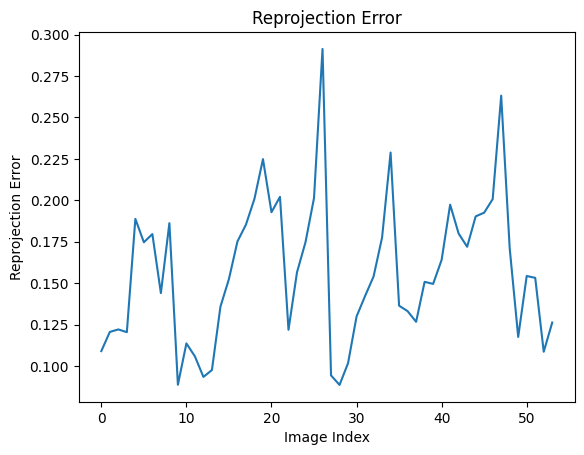

total error: 0.1567702760652318


In [13]:
# Plotting the reprojected errors
plt.plot(reprojection_errors)
plt.xlabel('Image Index')
plt.ylabel('Reprojection Error')
plt.title('Reprojection Error')
plt.show()
print( "total error: {}".format(mean_error/len(objpoints)) )

# Question 2

In [ ]:
# Connect to drive and change to required
# ENSURE YOU GIVE ALL THE PERMISSIONS WHILE CONNECTIONG
# YOUR GOOGLE DRIVE USING THS COMMAND
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [ ]:
# Change the working directory
path_to_folder = "ENPM673/tutorials/assets/Project3/Question2"
%cd /content/drive/My\ Drive/{path_to_folder}

/content/drive/My Drive/ENPM673/tutorials/assets/Project3/Question2


# Importing libraries

In [ ]:
import cv2
import numpy as np
import math
import glob
import pickle
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from IPython.display import clear_output

# Identifying matching features between the two images in each dataset using any feature matching algorithms

In [ ]:
# Stored all the images in a list
image_paths1 = ['classroom/im0.png', 'classroom/im1.png', 'traproom/im0.png', 'traproom/im1.png', 'storageroom/im0.png', 'storageroom/im1.png']  # Update with your image paths

# Loaded all the images
image_paths = [cv2.imread(image_path) for image_path in image_paths1]

# Ratio test to select good matches
good_matches = []

def matcher(image1, image2, criteria, trees, checks):
      pts1 = []
      pts2 = []
      # Create SIFT detector
      sift = cv2.SIFT_create()

      # FLANN parameters
      FLANN_INDEX_KDTREE = 1
      index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees= trees)
      search_params = dict(checks= checks)

      # Matcher
      flann = cv2.FlannBasedMatcher(index_params, search_params)

      # Detect keypoints and compute descriptors for both images
      keypoints1, descriptors1 = sift.detectAndCompute(image1, None)
      keypoints2, descriptors2 = sift.detectAndCompute(image2, None)

      # Matches descriptors using FLANN matcher
      matches = flann.knnMatch(descriptors1, descriptors2, k=2)

      for m, n in matches:
          if m.distance < criteria* n.distance:
              good_matches.append(m)
              pts2.append(keypoints2[m.trainIdx].pt)
              pts1.append(keypoints1[m.queryIdx].pt)


      # Draw matches only if enough good matches are found
      if len(good_matches) > 0:
          # Draw matches
          matched_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, good_matches, None,
                                          flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
          return matched_image, pts1, pts2
      else:
          print("No good matches found.")
          return None

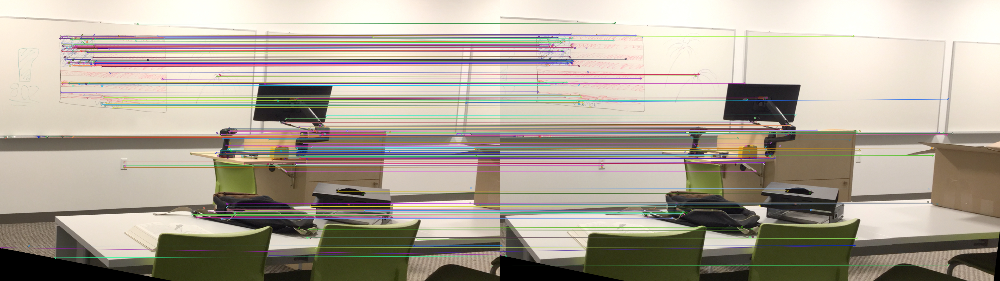

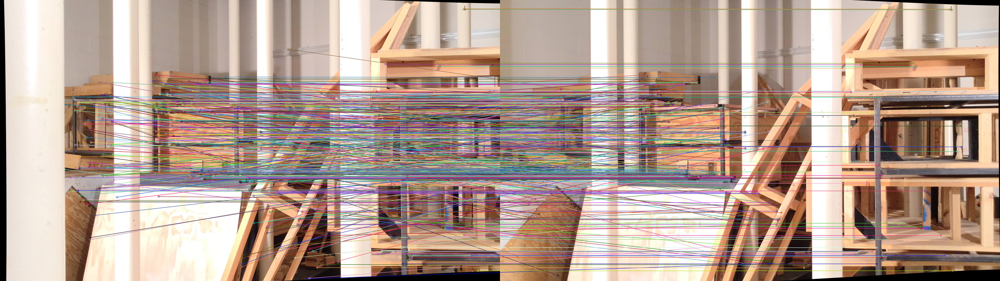

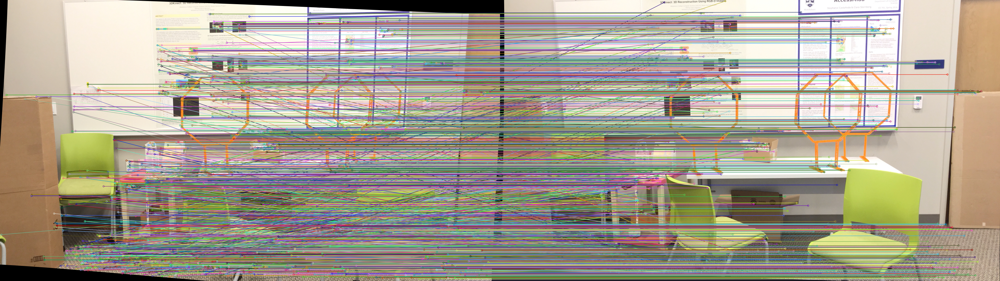

In [ ]:
matched_image_0_1, pts1, pts2 = matcher(image_paths[0], image_paths[1], 0.4, 2, 10)

cv2_imshow(matched_image_0_1)

matched_image_0_2, pts3, pts4 = matcher(image_paths[2], image_paths[3], 0.3, 5, 30)

cv2_imshow(matched_image_0_2)

matched_image_0_3, pts5, pts6 = matcher(image_paths[4], image_paths[5], 0.4, 5, 30)

cv2_imshow(matched_image_0_3)

# Deriving the Fundamental Matrix from the obtained good matches

In [ ]:
# Compute the fundamental matrix after choosing the relevant points using RANSAC
pts1 = np.int32(pts1)
pts2 = np.int32(pts2)

pts3 = np.int32(pts3)
pts4 = np.int32(pts4)

pts5 = np.int32(pts5)
pts6 = np.int32(pts6)

F1, mask1 = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC)

F2, mask2 = cv2.findFundamentalMat(pts3, pts4, cv2.FM_RANSAC)

F3, mask3 = cv2.findFundamentalMat(pts5, pts6, cv2.FM_RANSAC)

print(F1, "\n")

print(F2, "\n")

print(F3, "\n")

[[-1.21873395e-08 -2.58670331e-05  1.71398553e-02]
 [ 2.56227007e-05 -1.32106435e-06 -1.69644329e-01]
 [-1.68057241e-02  1.68071880e-01  1.00000000e+00]] 

[[-1.75517983e-19  1.06544735e-16 -7.45857294e-14]
 [-1.03481148e-16 -2.12749071e-18 -1.00000000e+00]
 [ 7.26303655e-14  1.00000000e+00  1.00000000e+00]] 

[[-6.63295126e-20 -3.05070789e-17  1.78094986e-14]
 [ 3.02192763e-17 -3.19843158e-19  5.00000000e-01]
 [-1.75150277e-14 -5.00000000e-01  1.00000000e+00]] 



# Opening the txt file and storing the important values as variables


In [ ]:
# Define the file path
file_path1 = "classroom/calib.txt"

file_path2 = "traproom/calib.txt"

file_path3 = "storageroom/calib.txt"



def store_data(file_path):
      # Define dictionaries to store the camera matrices
      cam0 = {}
      cam1 = {}
      # Open the file and read its contents
      with open(file_path, 'r') as file:
            # Read each line in the file
            for line in file:
                # Check if the line contains camera matrix values
                if line.startswith('cam0') or line.startswith('cam1'):
                    # Extract the matrix values and store them in the respective dictionary
                    parts = line.split('=')[1].strip().replace('[', '').replace(']', '').split(';')
                    matrix_values = [[float(val) for val in part.strip().split()] for part in parts]
                    if line.startswith('cam0'):
                        cam0 = matrix_values
                    elif line.startswith('cam1'):
                        cam1 = matrix_values
                elif line.startswith('baseline'):
                    baseline = line.split('=')[1]
                elif line.startswith('width'):
                    width = line.split('=')[1]
                elif line.startswith('height'):
                    height = line.split('=')[1]

      # Converting the list into numpy array
      cam0 = np.array(cam0)
      cam1 = np.array(cam1)
      focal_length = cam0[0][0]
      baseline = float(baseline)
      width = int(width)
      height = int(height)
      return cam0, cam1, baseline, width, height, focal_length

cam0, cam1, baseline1 , width1, height1, focal_length1 = store_data(file_path1)

cam2, cam3, baseline2 , width2, height2, focal_length2 = store_data(file_path2)

cam4, cam5, baseline3 , width3, height3, focal_length3 = store_data(file_path3)

# Obtaining Essential Matrix from the Fundamental Matrix

In [ ]:
E1 = np.dot(np.dot(cam1.T, F1), cam0)

E2 = np.dot(np.dot(cam3.T, F1), cam2)

E3 = np.dot(np.dot(cam5.T, F1), cam4)

E_calibrated1 = E1 * baseline1

E_calibrated2 = E2 * baseline2

E_calibrated3 = E3 * baseline3

print(E_calibrated1, '\n')

print(E_calibrated2, '\n')

print(E_calibrated3, '\n')

[[-2.52106130e+01 -5.35082955e+04  3.93740186e+03]
 [ 5.30028718e+04 -2.73274098e+03 -2.01344332e+05]
 [-3.69661111e+03  1.97805619e+05 -1.44966522e+02]] 

[[-1.12679183e+01 -2.39156065e+04  1.82298169e+03]
 [ 2.36897067e+04 -1.22140235e+03 -7.19943422e+04]
 [-1.73187283e+03  7.02821422e+04  1.33994872e+01]] 

[[-8.20244391e+00 -1.74092868e+04  1.20932592e+03]
 [ 1.72448437e+04 -8.89115809e+02 -5.78474028e+04]
 [-1.13890779e+03  5.66114991e+04 -1.84942656e+01]] 



# Decomposing Essential Matrix into Rotation and Translation Matrix

In [ ]:
def decompose_essential_matrix(E, points1, points2, cameraMatrix1, cameraMatrix2):

    # Function estimates the relative pose between two camera views using the essential matrix E,
    # corresponding point correspondences points1 and points2, as well as the intrinsic matrices cameraMatrix1 and cameraMatrix2
    retval, R, t, mask = cv2.recoverPose(E, points1, points2, cameraMatrix1, cameraMatrix2)

    # Ensure proper orientation of R
    if np.linalg.det(R) < 0:
        R *= -1

    return R, t

R1, t1 = decompose_essential_matrix(E_calibrated1, pts1, pts2, cam0, cam1)

R2, t2 = decompose_essential_matrix(E_calibrated2, pts3, pts4, cam2, cam3)

R3, t3 = decompose_essential_matrix(E_calibrated3, pts5, pts6, cam4, cam5)

print("Rotation Matrix classroom \n", R1)

print("Translation Matrix classroom \n", t1)

print("Rotation Matrix traproom \n", R2)

print("Translation Matrix traproom \n", t2)

print("Rotation Matrix storageroom \n", R3)

print("Translation Matrix storageroom \n", t3)

Rotation Matrix classroom 
 [[ 0.99997197 -0.00228323 -0.00713034]
 [ 0.00223464  0.99997429 -0.00681425]
 [ 0.00714571  0.00679812  0.99995136]]
Translation Matrix classroom 
 [[-0.9650716 ]
 [-0.01868437]
 [-0.26131915]]
Rotation Matrix traproom 
 [[ 0.9999376  -0.0033428  -0.0106592 ]
 [ 0.00326029  0.99996466 -0.00774872]
 [ 0.01068472  0.00771348  0.99991317]]
Translation Matrix traproom 
 [[-0.94629138]
 [-0.02402122]
 [-0.32242147]]
Rotation Matrix storageroom 
 [[ 0.99995522 -0.00279358 -0.00904188]
 [ 0.00272704  0.99996917 -0.00736327]
 [ 0.00906218  0.00733828  0.99993201]]
Translation Matrix storageroom 
 [[-0.95554802]
 [-0.01988211]
 [-0.29416439]]


# Applying perspective transformation to rectify images and ensure horizontal epipolar lines

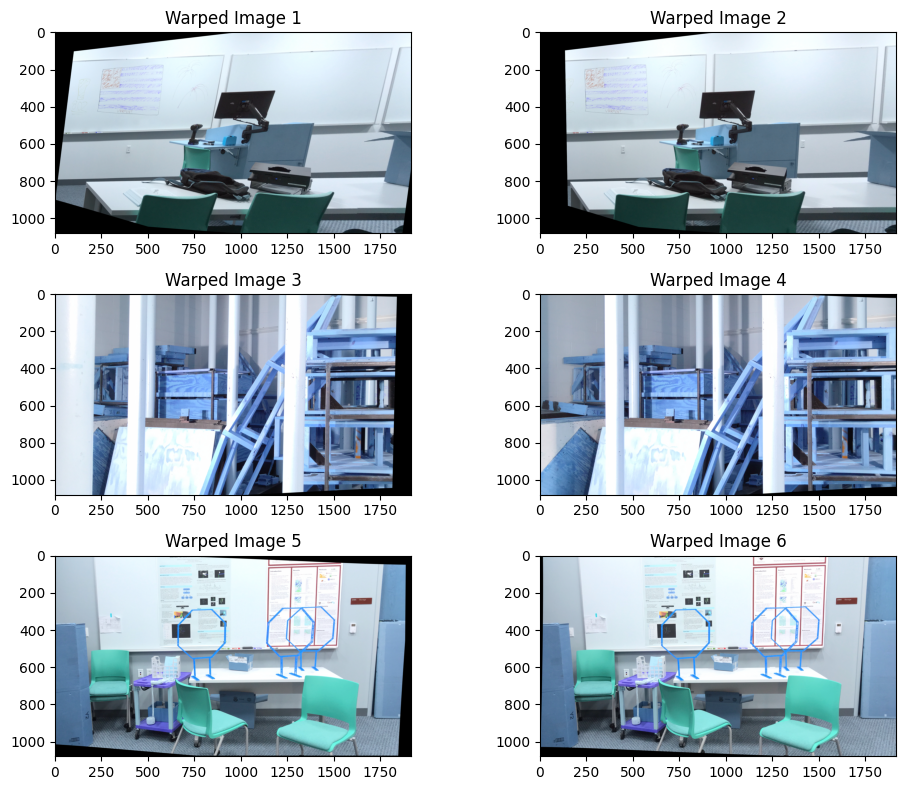

In [ ]:
distCoeffs1 = np.array([])
distCoeffs2 = np.array([])
imageSize = (width1, height1)

# Create a figure and axes for subplots
fig, axes = plt.subplots(3, 2, figsize=(10, 8))

'''
1st Dataset
'''
# Load the 1st dataset
image1 = cv2.imread('classroom/im0.png')
image2 = cv2.imread('classroom/im1.png')

# These transformations aim to align the epipolar lines in both images,
# ensuring that corresponding points lie on the same scanlines after rectification.
retval1, H1, H2 = cv2.stereoRectifyUncalibrated(pts1, pts2, F1, imageSize)

# Apply warp perspective to image2
warped_image2 = cv2.warpPerspective(image2, H2, (width1, height1))
warped_image1 = cv2.warpPerspective(image1, H1, (width1, height1))

'''
2nd Dataset
'''
# Load the 2nd dataset
image3 = cv2.imread('traproom/im0.png')
image4 = cv2.imread('traproom/im1.png')

# Compute stereo rectification
retva2, H3, H4 = cv2.stereoRectifyUncalibrated(pts3, pts4, F2, imageSize)

# Apply warp perspective to image2
warped_image4 = cv2.warpPerspective(image4, H4, (width1, height1))
warped_image3 = cv2.warpPerspective(image3, H3, (width1, height1))

'''
3rd Dataset
'''
# Load the 2nd dataset
image5 = cv2.imread('storageroom/im0.png')
image6 = cv2.imread('storageroom/im1.png')

# Compute stereo rectification
retval3, H5, H6 = cv2.stereoRectifyUncalibrated(pts5, pts6, F3, imageSize)

# Apply warp perspective to image2
warped_image5 = cv2.warpPerspective(image5, H5, (width1, height1))
warped_image6 = cv2.warpPerspective(image6, H6, (width1, height1))

# Display warped_image1 and warped_image2 side by side
axes[0, 0].imshow(warped_image1)
axes[0, 0].set_title('Warped Image 1')
axes[0, 1].imshow(warped_image2)
axes[0, 1].set_title('Warped Image 2')

# # Display warped_image3 and warped_image4 below each other
axes[1, 0].imshow(warped_image3)
axes[1, 0].set_title('Warped Image 3')
axes[1, 1].imshow(warped_image4)
axes[1, 1].set_title('Warped Image 4')

# # Display warped_image5 and warped_image6 below each other
axes[2, 0].imshow(warped_image5)
axes[2, 0].set_title('Warped Image 5')
axes[2, 1].imshow(warped_image6)
axes[2, 1].set_title('Warped Image 6')

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

# Print the homography matrices (H1 and H2) for rectification

In [ ]:
print("Homography Matrix for first image\n", H1, "\n")

print("Homography Matrix for second image\n", H2, "\n")

print("Homography Matrix for third image\n", H3, "\n")

print("Homography Matrix for fourth image\n", H4,"\n")

print("Homography Matrix for fifth image\n", H5, "\n")

print("Homography Matrix for sixth image\n", H6,"\n")

Homography Matrix for first image
 [[-1.40222148e-01  2.09420618e-02 -2.02728094e+01]
 [ 1.98448485e-02 -1.68699696e-01 -2.08109233e+01]
 [ 3.02340293e-05 -8.99066341e-07 -2.00610384e-01]] 

Homography Matrix for second image
 [[ 8.25425455e-01  1.78415992e-02  1.57957099e+02]
 [-1.19676811e-01  9.97646759e-01  1.16160488e+02]
 [-1.81605231e-04 -3.92540321e-06  1.17646074e+00]] 

Homography Matrix for third image
 [[ 9.66956103e-01 -2.36881909e-02 -1.75051609e+01]
 [ 1.30164522e-13  1.00000000e+00  1.00000000e+00]
 [ 2.10025882e-16  5.10335833e-17  1.00000000e+00]] 

Homography Matrix for fourth image
 [[ 1.00000000e+00 -1.71581175e-14  9.09494702e-12]
 [ 1.71581175e-14  1.00000000e+00 -1.63709046e-11]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 

Homography Matrix for fifth image
 [[ 5.00037142e-01 -4.06750264e-03 -1.66273560e+01]
 [ 1.75150277e-14  5.00000000e-01 -1.00000000e+00]
 [ 3.02192763e-17 -1.06295664e-30  5.00000000e-01]] 

Homography Matrix for sixth image
 [[ 1.000

# Visualize epipolar lines and feature points on both rectified images.



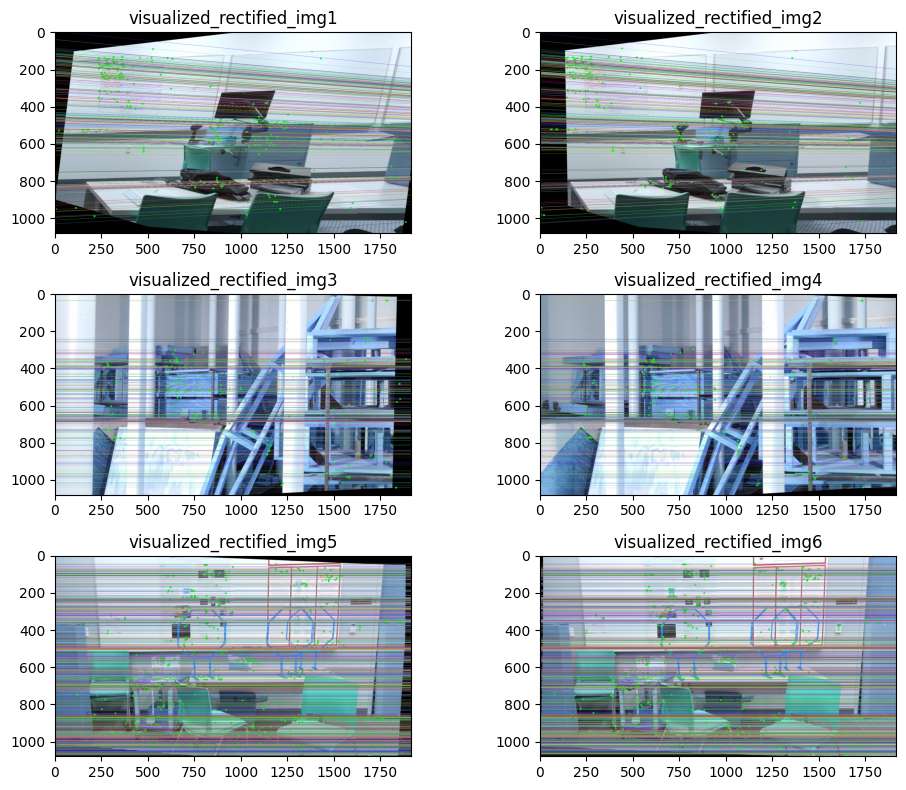

In [ ]:
fig, axes = plt.subplots(3, 2, figsize=(10, 8))
def visualize_epipolar_lines(src_pts, dst_pts, rectified_img1, rectified_img2, F):

    rectified_img1_copy = rectified_img1.copy()
    rectified_img2_copy = rectified_img2.copy()
    # Draw matching feature points on the rectified images
    for pt1, pt2 in zip(src_pts, dst_pts):
        pt1 = (round(pt1[0]) , round(pt1[1]))
        pt2 = (round(pt2[0]) , round(pt2[1]))
        cv2.circle(rectified_img1_copy, pt1, 5, (0, 255, 0), -1)
        cv2.circle(rectified_img2_copy, pt2, 5, (0, 255, 0), -1)

    # Draw epipolar lines on the rectified images after transformation
    lines1 = cv2.computeCorrespondEpilines(src_pts, 1, F)
    lines1 = lines1.reshape(-1, 3)
    lines2 = cv2.computeCorrespondEpilines(dst_pts, 2, F)
    lines2 = lines2.reshape(-1, 3)


    for line1, line2 in zip(lines1, lines2):
        color = tuple(np.random.randint(0, 255, 3).tolist())
        x0, y0 = map(int, [0, -line1[2]/line1[1]])
        x1, y1 = map(int, [rectified_img1_copy.shape[1], -(line1[2]+line1[0]*rectified_img1_copy.shape[1])/line1[1]])
        cv2.line(rectified_img2_copy, (x0, y0), (x1, y1), color, 1)

        x0, y0 = map(int, [0, -line2[2]/line2[1]])
        x1, y1 = map(int, [rectified_img2_copy.shape[1], -(line2[2]+line2[0]*rectified_img2_copy.shape[1])/line2[1]])
        cv2.line(rectified_img1_copy, (x0, y0), (x1, y1), color, 1)

    return rectified_img1_copy, rectified_img2_copy

# Visualize epipolar lines and feature points on rectified images
visualized_rectified_img1, visualized_rectified_img2 = visualize_epipolar_lines(pts1, pts2, warped_image1, warped_image2, F1)
visualized_rectified_img3, visualized_rectified_img4 = visualize_epipolar_lines(pts3, pts4, warped_image3, warped_image4, F2)
visualized_rectified_img5, visualized_rectified_img6 = visualize_epipolar_lines(pts5, pts6, warped_image5, warped_image6, F3)

axes[0,0].imshow(visualized_rectified_img1)
axes[0,0].set_title("visualized_rectified_img1")
axes[0,1].imshow(visualized_rectified_img2)
axes[0,1].set_title("visualized_rectified_img2")

axes[1,0].imshow(visualized_rectified_img3)
axes[1,0].set_title("visualized_rectified_img3")
axes[1,1].imshow(visualized_rectified_img4)
axes[1,1].set_title("visualized_rectified_img4")

axes[2,0].imshow(visualized_rectified_img5)
axes[2,0].set_title("visualized_rectified_img5")
axes[2,1].imshow(visualized_rectified_img6)
axes[2,1].set_title("visualized_rectified_img6")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

# Calculate the disparity map representing the pixel-wise differences between the two images.

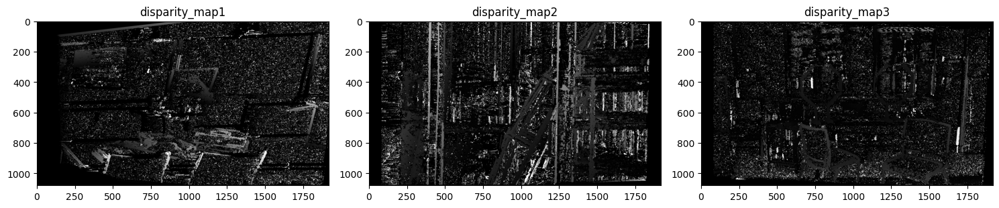

In [ ]:
import cv2
import numpy as np

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

def calculate_disparity_map(rectified_img1, rectified_img2):
    # Convert rectified images to grayscale
    gray1 = cv2.cvtColor(rectified_img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(rectified_img2, cv2.COLOR_BGR2GRAY)

    stereo = cv2.StereoBM_create(numDisparities=80, blockSize=7)
    stereo.setPreFilterType(cv2.STEREO_BM_PREFILTER_NORMALIZED_RESPONSE)
    stereo.setMinDisparity(0)

    # The resulting disparity map contains the disparity values (horizontal shifts) for each pixel,
    # representing the differences in horizontal position between corresponding points in the left and right images
    disparity = stereo.compute(gray1, gray2)

    return disparity

# Calculate the disparity map
disparity_map1 = calculate_disparity_map(warped_image1, warped_image2)
disparity_map2 = calculate_disparity_map(warped_image3, warped_image4)
disparity_map3 = calculate_disparity_map(warped_image5, warped_image6)

# Display the disparity maps
axes[0].imshow(disparity_map1, cmap='gray')
axes[0].set_title("disparity_map1")

axes[1].imshow(disparity_map2, cmap='gray')
axes[1].set_title("disparity_map2")

axes[2].imshow(disparity_map3, cmap='gray')
axes[2].set_title("disparity_map3")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

# Rescale the disparity map and save it as grayscale using heat map conversion

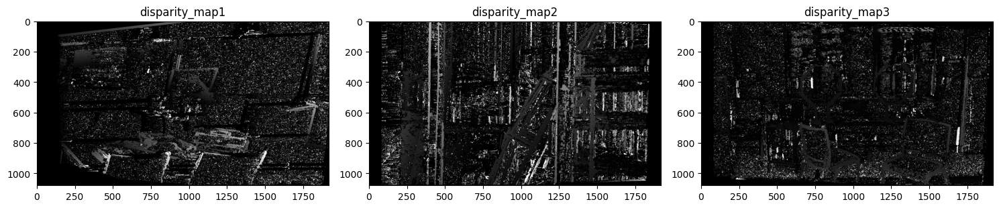

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# This functions rescales the disparity map to 0-255
disp_rescaled1 = cv2.normalize(disparity_map1, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
disp_rescaled2 = cv2.normalize(disparity_map2, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
disp_rescaled3 = cv2.normalize(disparity_map3, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

# Save the rescaled disparity map as grayscale
cv2.imwrite('classroom/disparity_map_gray.png', disp_rescaled1)
cv2.imwrite('traproom/disparity_map_gray.png', disp_rescaled2)
cv2.imwrite('storageroom/disparity_map_gray.png', disp_rescaled3)


# Display the disparity maps
axes[0].imshow(disp_rescaled1, cmap='gray')
axes[0].set_title("disparity_map1")

axes[1].imshow(disp_rescaled2, cmap='gray')
axes[1].set_title("disparity_map2")

axes[2].imshow(disp_rescaled3, cmap='gray')
axes[2].set_title("disparity_map3")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

# Rescale the disparity map and save it as color images using heat map conversion

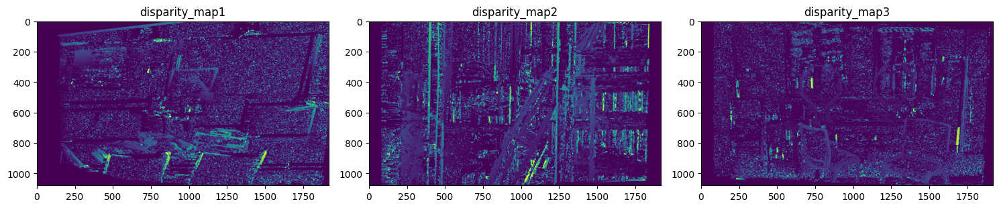

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Apply a colormap to create a color representation of the disparity map (heatmap)
disp_color1 = cv2.applyColorMap(disp_rescaled1, cv2.COLORMAP_JET)
disp_color2 = cv2.applyColorMap(disp_rescaled2, cv2.COLORMAP_JET)
disp_color3 = cv2.applyColorMap(disp_rescaled3, cv2.COLORMAP_JET)

# Save the color disparity map
cv2.imwrite('classroom/disparity_map_color.png', disp_color1)
cv2.imwrite('traproom/disparity_map_color.png', disp_color2)
cv2.imwrite('storageroom/disparity_map_color.png', disp_color3)

# Display the disparity maps
axes[0].imshow(disp_rescaled1)
axes[0].set_title("disparity_map1")

axes[1].imshow(disp_rescaled2)
axes[1].set_title("disparity_map2")

axes[2].imshow(disp_rescaled3)
axes[2].set_title("disparity_map3")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

# Utilize the disparity information to compute depth values for each pixel.

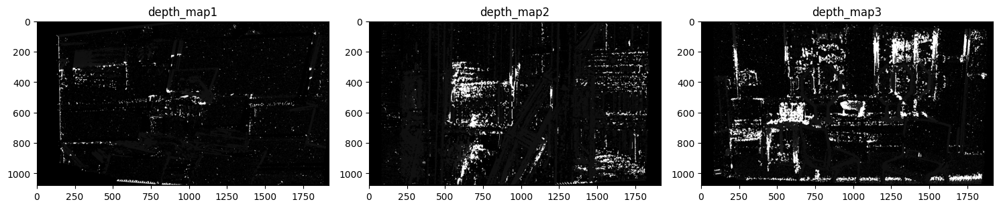

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

def compute_depth(disparity_map, baseline, focal_length):
    # Ensure that the disparity map does not contain zero values to avoid division by zero
    disparity_map[disparity_map == 0] = 1

    # Compute depth map using the formula
    depth_map = (baseline * focal_length) / disparity_map

    return depth_map

# Compute depth map from the disparity map
depth_map1 = compute_depth(disparity_map1.astype(np.float32), baseline1, focal_length1)
depth_map2 = compute_depth(disparity_map2.astype(np.float32), baseline2, focal_length2)
depth_map3 = compute_depth(disparity_map3.astype(np.float32), baseline3, focal_length3)

# Display the depth maps
axes[0].imshow(depth_map1, cmap='gray')
axes[0].set_title("depth_map1")

axes[1].imshow(depth_map2, cmap='gray')
axes[1].set_title("depth_map2")

axes[2].imshow(depth_map3, cmap='gray')
axes[2].set_title("depth_map3")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

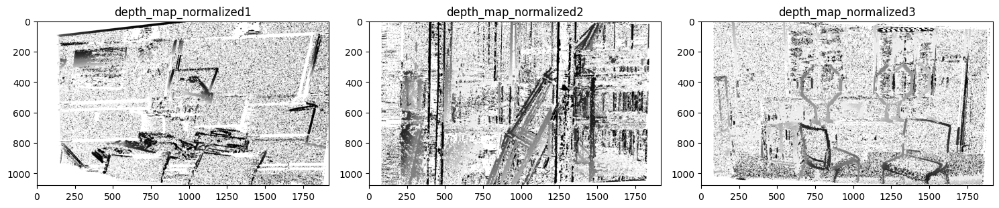

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Load the disparity map (previously computed)
disparity_map1 = cv2.imread('classroom/disparity_map_color.png', cv2.IMREAD_GRAYSCALE).astype(np.float32)
disparity_map2 = cv2.imread('traproom/disparity_map_color.png', cv2.IMREAD_GRAYSCALE).astype(np.float32)
disparity_map3 = cv2.imread('storageroom/disparity_map_color.png', cv2.IMREAD_GRAYSCALE).astype(np.float32)

# Compute depth map from the disparity map
depth_map1 = compute_depth(disparity_map1, baseline1, focal_length1)
depth_map2 = compute_depth(disparity_map2, baseline2, focal_length2)
depth_map3 = compute_depth(disparity_map3, baseline3, focal_length3)

# Normalize the depth map for visualization
depth_map_normalized1 = cv2.normalize(depth_map1, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
depth_map_normalized2 = cv2.normalize(depth_map2, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
depth_map_normalized3 = cv2.normalize(depth_map3, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

# Save or display the depth image
cv2.imwrite('classroom/depth_image_gray.png', depth_map_normalized1)
cv2.imwrite('traproom/depth_image_gray.png', depth_map_normalized2)
cv2.imwrite('storageroom/depth_image_gray.png', depth_map_normalized3)

# Display the disparity maps
axes[0].imshow(depth_map_normalized1, cmap='gray')
axes[0].set_title("depth_map_normalized1")

axes[1].imshow(depth_map_normalized2, cmap='gray')
axes[1].set_title("depth_map_normalized2")

axes[2].imshow(depth_map_normalized3, cmap='gray')
axes[2].set_title("depth_map_normalized3")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()

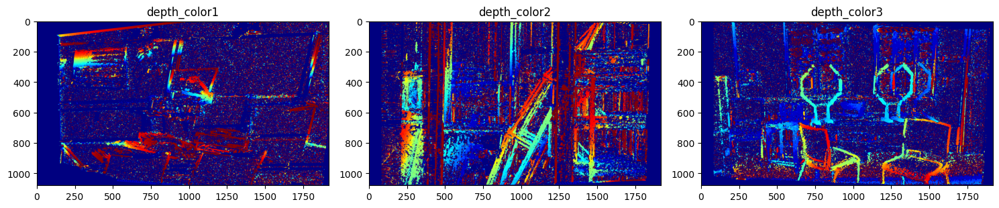

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Apply a colormap to create a color representation of the disparity map (heatmap)
depth_color1 = cv2.applyColorMap(depth_map_normalized1, cv2.COLORMAP_JET)
depth_color2 = cv2.applyColorMap(depth_map_normalized2, cv2.COLORMAP_JET)
depth_color3 = cv2.applyColorMap(depth_map_normalized3, cv2.COLORMAP_JET)

depth_color1 =  cv2.cvtColor(depth_color1, cv2.COLOR_RGB2BGR)
depth_color1 =  cv2.cvtColor(depth_color1, cv2.COLOR_RGB2BGR)
depth_color1 =  cv2.cvtColor(depth_color1, cv2.COLOR_RGB2BGR)

# Save the color disparity map
cv2.imwrite('classroom/depth_image_color.png', depth_color1)
cv2.imwrite('traproom/depth_image_color.png', depth_color2)
cv2.imwrite('storageroom/depth_image_color.png', depth_color3)

depth_color1 =  cv2.cvtColor(depth_color1, cv2.COLOR_BGR2RGB)
depth_color1 =  cv2.cvtColor(depth_color1, cv2.COLOR_BGR2RGB)
depth_color1 =  cv2.cvtColor(depth_color1, cv2.COLOR_BGR2RGB)

# Display the disparity maps
axes[0].imshow(depth_color1)
axes[0].set_title("depth_color1")

axes[1].imshow(depth_color2)
axes[1].set_title("depth_color2")

axes[2].imshow(depth_color3)
axes[2].set_title("depth_color3")

# Adjust layout to prevent overlap
plt.tight_layout()

plt.show()